In [1]:
from multissl.models import FeaturePCA
from multissl.data import OrthoChipDataset
from multissl.eval.ortho_reconstruct import predict_ortho
from torchvision import transforms
from torch.utils.data import DataLoader
import os
from multissl.plotting.false_color import visualize_features_from_model

In [2]:
CONFIG = {
    # Dataset parameters
    "img_dir": "../dataset/vineseg/imgs",  # Update with your path
    "mask_dir": "../dataset/vineseg/masks",  # Update with your path
    "unlabeled_dir": ["../dataset/vineseg/imgs/train_qbaixo5","../dataset/vineseg/imgs/train_valdoeiro5",  ],  # Optional path or list of paths to unlabeled images
    "img_size": 224,
    "batch_size": 4,
    "num_workers": 0,
    
    # Model parameters
    "pretrained_checkpoint": "../checkpoints_swin/last.ckpt",
    "backbone_type": "swin-tiny",  # Options: resnet18, resnet50, vit-s, swin-tiny
    "num_classes": 2,
    "in_channels": 4,  # 4 channels for R+G+RE+NIR
    "hidden_dim": 256,
    
    # Training parameters
    "epochs": 300,
    "lr": 3e-4,
    "weight_decay": 1e-4,
    "consistency_weight": 1.0,
    "consistency_rampup": 10,  # Epochs for ramping up consistency weight
    "check_val_every_n_epoch": 5,  # Validate every N epochs
    
    # Domain adaptation parameters
    "unfreeze_backbone_after": None,  # Unfreeze backbone after this many epochs (None to keep frozen)
    
    # Misc
    "seed": 42,
    "class_names": ["Background", "Vines"],  # Update with your class names
    "checkpoint_dir": "domain_adaptive_checkpoints",
    "project_name": "1SHOT_Segmentation",
    "class_names": ["Background","Vines"],  # Update with your class names
    "class_weights": [1.0,1.0],

}

In [3]:
import geopandas as gpd
from shapely.geometry import MultiPolygon, Polygon

def buffer_geometry(geom, buffer_amount=3):
    """
    Expand the geometry by adding buffer_amount to max coordinates 
    and subtracting buffer_amount from min coordinates
    """
    if geom.is_empty:
        return geom
        
    # Get the minimum and maximum coordinates
    minx, miny, maxx, maxy = geom.bounds
    
    # Create a new rectangle with buffered bounds
    buffered_box = Polygon([
        (minx - buffer_amount, miny - buffer_amount),
        (maxx + buffer_amount, miny - buffer_amount),
        (maxx + buffer_amount, maxy + buffer_amount),
        (minx - buffer_amount, maxy + buffer_amount)
    ])
    
    # Get the union of the original geometry with the buffered box
    # Using union instead of intersection to expand the geometry
    result = geom.union(buffered_box)
    
    # If the result is a Polygon and the original was a MultiPolygon, 
    # convert back to MultiPolygon for consistency
    if isinstance(geom, MultiPolygon) and isinstance(result, Polygon):
        result = MultiPolygon([result])
        
    return result




In [8]:
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

def apply_tsne_to_rgb_arrays(array1, array2, n_samples=1000, perplexity=30, n_components=2, random_state=42):
    """
    Apply t-SNE to two RGB arrays with the same shape, using random sampling.
    
    Parameters:
    -----------
    array1, array2 : numpy.ndarray
        RGB arrays with shape (height, width, 3)
    n_samples : int, default=1000
        Number of pixels to sample from each image
    perplexity : int, default=30
        The perplexity parameter for t-SNE
    n_components : int, default=2
        Number of dimensions in the embedded space
    random_state : int, default=42
        For reproducibility
        
    Returns:
    --------
    tsne_array1, tsne_array2 : numpy.ndarray
        The t-SNE embeddings for samples from each array
    """
    # Check if arrays have the same shape
    if array1.shape != array2.shape:
        raise ValueError("Arrays must have the same shape")
    
    # Get dimensions
    height, width, channels = array1.shape

    
    # Reshape the arrays to vectors
    vectors1 = array1.reshape(height * width, channels)
    vectors2 = array2.reshape(height * width, channels)
    
    # Determine total number of pixels
    total_pixels = height * width
    
    # Make sure we don't sample more than what's available
    n_samples = min(n_samples, total_pixels)
    
    # Set random seed for reproducibility
    np.random.seed(random_state)
    
    # Sample indices randomly
    sample_indices = np.random.choice(total_pixels, n_samples, replace=False)
    
    # Extract sampled pixels
    sampled_vectors1 = vectors1[sample_indices]
    sampled_vectors2 = vectors2[sample_indices]
    
    # Combine both arrays for t-SNE
    combined_vectors = np.vstack((sampled_vectors1, sampled_vectors2))
    
    # Apply t-SNE
    tsne = TSNE(n_components=n_components, perplexity=perplexity, random_state=random_state)
    tsne_results = tsne.fit_transform(combined_vectors)
    
    # Split the results back to correspond to the original arrays
    tsne_array1 = tsne_results[:n_samples]
    tsne_array2 = tsne_results[n_samples:]
    
    return tsne_array1, tsne_array2, sample_indices

In [4]:
import xarray as xr
import rioxarray as rxr
import uavgeo as ug
import numpy as np
import geopandas as gpd


ortho = "../dataset/altum_vineyard_segmentation/esac/altum/ortho.tif"
mask = "../dataset/altum_vineyard_segmentation/esac/altum/mask.png"

esac_ortho = rxr.open_rasterio(ortho, masked =True)



bands = [2,3,4,5] #(GREEN, RED,REDEDGE,NIR)
esac_ortho = esac_ortho.sel(band=bands)
esac_ortho = 255.0 * (esac_ortho - esac_ortho.min()) / (esac_ortho.max() - esac_ortho.min())
esac_ortho = esac_ortho.astype(np.uint8)

# Make esac 1 and esac 2, like the study
esac_shp = gpd.read_file("../dataset/altum_vineyard_segmentation/esac/esac12.geojson")
esac1_geom = esac_shp.geometry[esac_shp["id"]==1]
esac2_geom = esac_shp.geometry[esac_shp["id"]==2]
# Apply this function to your GeoDataFrame
# Assuming your GeoDataFrame is called 'gdf'
# Apply to your GeoSeries
esac1_geom = esac1_geom.apply(lambda geom: buffer_geometry(geom, 3))
esac2_geom = esac2_geom.apply(lambda geom: buffer_geometry(geom, 3))
esac1_ortho = esac_ortho.rio.clip(esac1_geom.values, esac_shp.crs)
esac2_ortho = esac_ortho.rio.clip(esac2_geom.values, esac_shp.crs)



qbaixo_ortho = rxr.open_rasterio(ortho.replace("esac", "qbaixo"), masked =True)
qbaixo_mask =rxr.open_rasterio(mask.replace("esac", "qbaixo"), masked =True)

valdoeiro_ortho = rxr.open_rasterio(ortho.replace("esac", "valdoeiro"), masked =True)
valdoeiro_mask = rxr.open_rasterio(mask.replace("esac", "valdoeiro").replace(".png", ".tif"), masked =True)

# has some gaping holes (we can fix that later y only selecting chips without edges? hmmm

# aligning the esac mask to ms rasters:
# Esac has the identical shape so we can just plop the values into the shape/crs  
# one layer has all the info we need
qbaixo_mask = qbaixo_mask.sel(band=1)
empty = xr.zeros_like(qbaixo_ortho.sel(band=2))

empty.values =qbaixo_mask.values

qbaixo_mask = empty.copy()

# Get the shapes of both rasters
ortho_shape = valdoeiro_ortho.shape
mask_shape = valdoeiro_mask.shape

# Calculate the difference in size
height_diff = ortho_shape[1] - mask_shape[1]  # Difference in y dimension
width_diff = ortho_shape[2] - mask_shape[2]   # Difference in x dimension

# Crop the ortho to match the mask size, keeping the alignment from top right
# This means we'll remove pixels from the bottom and left
cropped_ortho = valdoeiro_ortho.isel(
    y=slice(0, mask_shape[1]),           # Keep the top portion
    x=slice(width_diff, ortho_shape[2])  # Keep the right portion
)
empty = xr.zeros_like(cropped_ortho.sel(band=2))

empty.values =valdoeiro_mask.sel(band=1).values

valdoeiro_mask = empty.copy()
valdoeiro_ortho = cropped_ortho.copy()

valdoeiro_ortho = valdoeiro_ortho.sel(band=bands)
valdoeiro_ortho = 255.0 * (valdoeiro_ortho - valdoeiro_ortho.min()) / (valdoeiro_ortho.max() - valdoeiro_ortho.min())
valdoeiro_ortho = valdoeiro_ortho.astype(np.uint8)

qbaixo_ortho = qbaixo_ortho.sel(band=bands)
qbaixo_ortho = 255.0 * (qbaixo_ortho - qbaixo_ortho.min()) / (qbaixo_ortho.max() - qbaixo_ortho.min())
qbaixo_ortho = qbaixo_ortho.astype(np.uint8)

C:\Users\judoj\mambaforge\envs\lightly\lib\site-packages\xarray\core\duck_array_ops.py:239: RuntimeWarning: invalid value encountered in cast
  return data.astype(dtype, **kwargs)
C:\Users\judoj\mambaforge\envs\lightly\lib\site-packages\rioxarray\_io.py:1132: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
C:\Users\judoj\mambaforge\envs\lightly\lib\site-packages\rioxarray\_io.py:1132: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
C:\Users\judoj\mambaforge\envs\lightly\lib\site-packages\xarray\core\duck_array_ops.py:239: RuntimeWarning: invalid value encountered in cast
  return data.astype(dtype, **kwargs)
C:\Users\judoj\mambaforge\envs\lightly\lib\site-packages\xarray\core\duck_array_ops.py:239: Runt

In [5]:
ortho_dataset_e1 = OrthoChipDataset(ortho = esac1_ortho,
        img_size= (224, 224),
        remove_empty_chips = True,
        empty_threshold = 1)

ortho_dataset_e2 = OrthoChipDataset(ortho = esac2_ortho,
        img_size= (224, 224),
        remove_empty_chips = False,
        empty_threshold = 1)



ortho_dataset_v = OrthoChipDataset(ortho = valdoeiro_ortho,
        img_size= (224, 224),
        remove_empty_chips = True,
        empty_threshold = 1)

ortho_dataset_q = OrthoChipDataset(ortho = qbaixo_ortho,
        img_size= (224, 224),
        remove_empty_chips = True,
        empty_threshold = 1)




In [6]:
swinmodel = FeaturePCA(backbone_type=CONFIG["backbone_type"],
        pretrained_path=CONFIG["pretrained_checkpoint"],
        in_channels=CONFIG["in_channels"],
        layer="stem",
        out_channels=3,
        img_size=CONFIG["img_size"],
        lr=1e-4,
        weight_decay=1e-5,
        use_online_pca=False, 
        normalize_output=True
    )

Loaded pretrained weights. Missing keys: 0, Unexpected keys: 0
Feature extractor initialized with stem features:
  - Channels: 96
  - Spatial size: 56x56
  - Original image size: 224x224


In [7]:
from multissl.models import SegmentationModel
import copy
import torch
best_model_path = "vineseg_checkpoints/swin-ee-all.pth"
device = "cuda"
best_model = SegmentationModel(backbone_type = CONFIG["backbone_type"])
sd = torch.load(best_model_path)

best_model.load_state_dict(sd)

extractor = copy.deepcopy(best_model.feature_extractor)


swinmodelee = FeaturePCA(backbone_type=CONFIG["backbone_type"],
        loaded_weights = extractor,
        in_channels=CONFIG["in_channels"],
        layer="stem",
        out_channels=3,
        img_size=CONFIG["img_size"],
        lr=1e-4,
        weight_decay=1e-5,
        use_online_pca=False, 
        normalize_output=True
    )

Detected feature dimensions: layer1=96, layer2=192, layer3=384, layer4=768
Feature extractor initialized with stem features:
  - Channels: 96
  - Spatial size: 56x56
  - Original image size: 224x224


In [9]:

e2_pca_swin = predict_ortho(
    model = swinmodel,
    ortho_dataset = ortho_dataset_e2,
    ortho_template = esac2_ortho,
    batch_size = 1,
    num_workers = 4,
    output_channels=3
)

PCA computed with explained variance ratios: [0.73925024 0.07618512 0.05563708]


In [10]:
e2_pca_swin_ee = predict_ortho(
    model = swinmodelee,
    ortho_dataset = ortho_dataset_e2,
    ortho_template = esac2_ortho,
    batch_size = 1,
    num_workers = 4,
    output_channels=3
)

PCA computed with explained variance ratios: [0.74348426 0.07855298 0.05542727]


In [11]:
qee = e2_pca_swin_ee.values.transpose(1,2,0)
qbb = e2_pca_swin.values.transpose(1,2,0)

# Apply t-SNE
tsne_array1, tsne_array2, indices = apply_tsne_to_rgb_arrays(qee, qbb, n_samples = 10000)


In [12]:
from matplotlib.colors import LinearSegmentedColormap
import matplotlib
# Get the RdYlGn colormap
cmap = matplotlib.colormaps["RdYlGn"]
vmin = 0.0
vmax = 0.7
r  = esac2_ortho.sel(band =2 )
nir = esac2_ortho.sel(band =4 )
ndvi = (nir-r)/(r+nir)
ndvi = ndvi.rio.reproject_match(e2_pca_swin)

ndvi_array = ndvi.values
# Normalize the NDVI values between 0 and 1 based on vmin and vmax
# Clip values to ensure they're within range
normalized_ndvi = np.clip((ndvi_array - vmin) / (vmax - vmin), 0, 1)

# Convert to RGB using the colormap
# The result will be shape (*ndvi_array.shape, 4) with RGBA values
rgba_array = cmap(normalized_ndvi)

# Remove the alpha channel to get RGB
rgb_array = rgba_array[..., :3]

height,width, channels = rgb_array.shape
rgb_ndvi_array_cs =  rgb_array.reshape(height * width, channels)[indices]

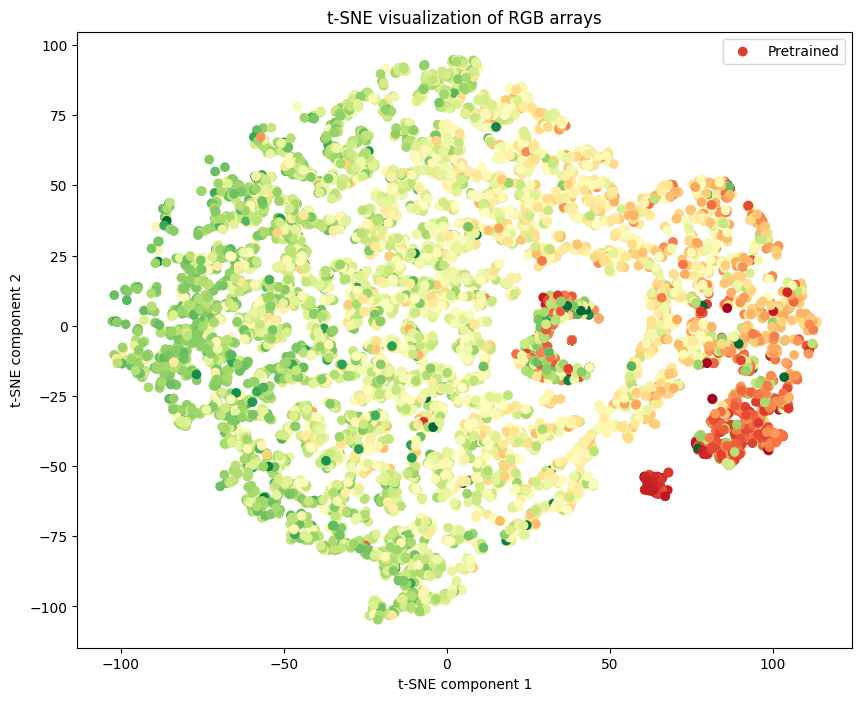

In [32]:
# Plot the results
plt.figure(figsize=(10, 8))

plt.scatter(tsne_array2[:, 0], tsne_array2[:, 1], c=rgb_ndvi_array_cs, alpha=1, label='Pretrained')
#plt.scatter(tsne_array1[:, 0], tsne_array1[:, 1], c=rgb_ndvi_array_cs, edgecolors="black",linewidth = 0.1, label='End-to-end')
plt.legend()
plt.title('t-SNE visualization of RGB arrays')
plt.xlabel('t-SNE component 1')
plt.ylabel('t-SNE component 2')
plt.show()

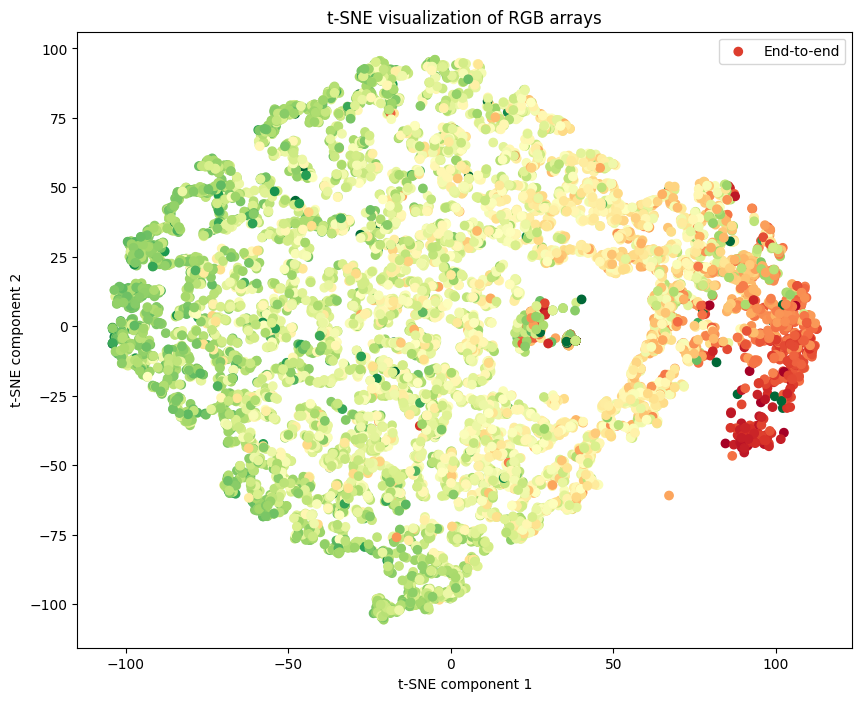

In [31]:
# Plot the results
plt.figure(figsize=(10, 8))

#plt.scatter(tsne_array2[:, 0], tsne_array2[:, 1], c=rgb_ndvi_array_cs, alpha=1, label='Pretrained')
plt.scatter(tsne_array1[:, 0], tsne_array1[:, 1], c=rgb_ndvi_array_cs,  label='End-to-end')
plt.legend()
plt.title('t-SNE visualization of RGB arrays')
plt.xlabel('t-SNE component 1')
plt.ylabel('t-SNE component 2')
plt.show()

In [15]:
e1_pca_swin = predict_ortho(
    model = swinmodel,
    ortho_dataset = ortho_dataset_e1,
    ortho_template = esac1_ortho,
    batch_size = 1,
    num_workers = 4,
    output_channels=3
)

In [16]:
e1_pca_swin_ee = predict_ortho(
    model = swinmodelee,
    ortho_dataset = ortho_dataset_e1,
    ortho_template = esac1_ortho,
    batch_size = 1,
    num_workers = 4,
    output_channels=3
)

In [17]:
v_pca_swin = predict_ortho(
    model = swinmodel,
    ortho_dataset = ortho_dataset_v,
    ortho_template = valdoeiro_ortho,
    batch_size = 1,
    num_workers = 4,
    output_channels=3
)

In [18]:
v_pca_swin_ee = predict_ortho(
    model = swinmodelee,
    ortho_dataset = ortho_dataset_v,
    ortho_template = valdoeiro_ortho,
    batch_size = 1,
    num_workers = 4,
    output_channels=3
)

In [19]:
q_pca_swin =predict_ortho(
    model = swinmodel,
    ortho_dataset = ortho_dataset_q,
    ortho_template = qbaixo_ortho,
    batch_size = 1,
    num_workers = 4,
    output_channels=3
)

In [20]:
q_pca_swin_ee = predict_ortho(
    model = swinmodelee,
    ortho_dataset = ortho_dataset_q,
    ortho_template = qbaixo_ortho,
    batch_size = 1,
    num_workers = 4,
    output_channels=3
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.2443604..8.518041].


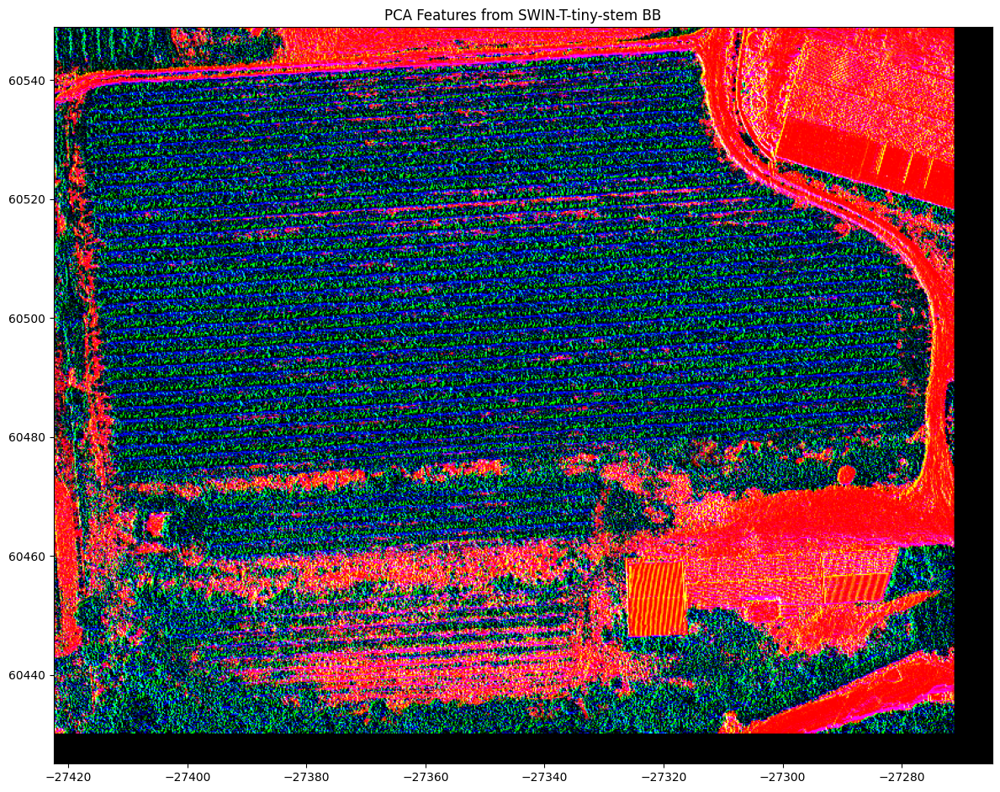

In [21]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = e2_pca_swin.values.transpose(1,2,0)
e = [esac2_ortho.x.min(), esac2_ortho.x.max(), 
                       esac2_ortho.y.min(), esac2_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem BB')

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.6397643..7.4250746].


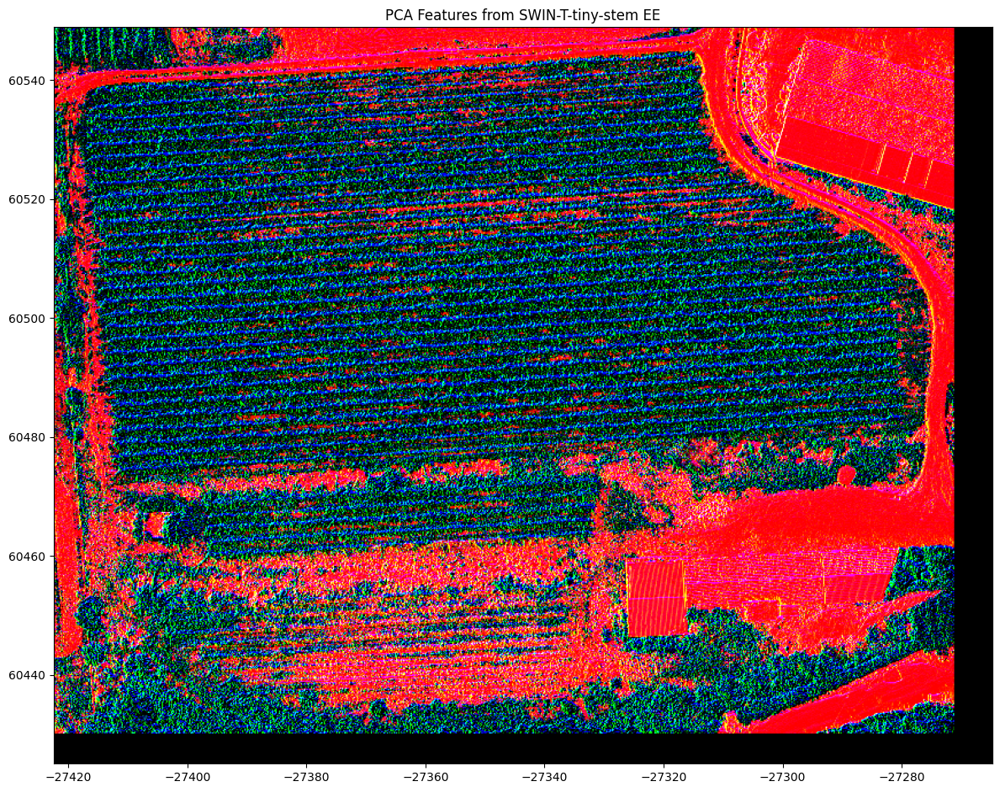

In [22]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = e2_pca_swin_ee.values.transpose(1,2,0)
e = [esac2_ortho.x.min(), esac2_ortho.x.max(), 
                       esac2_ortho.y.min(), esac2_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem EE')

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.229466..8.414002].


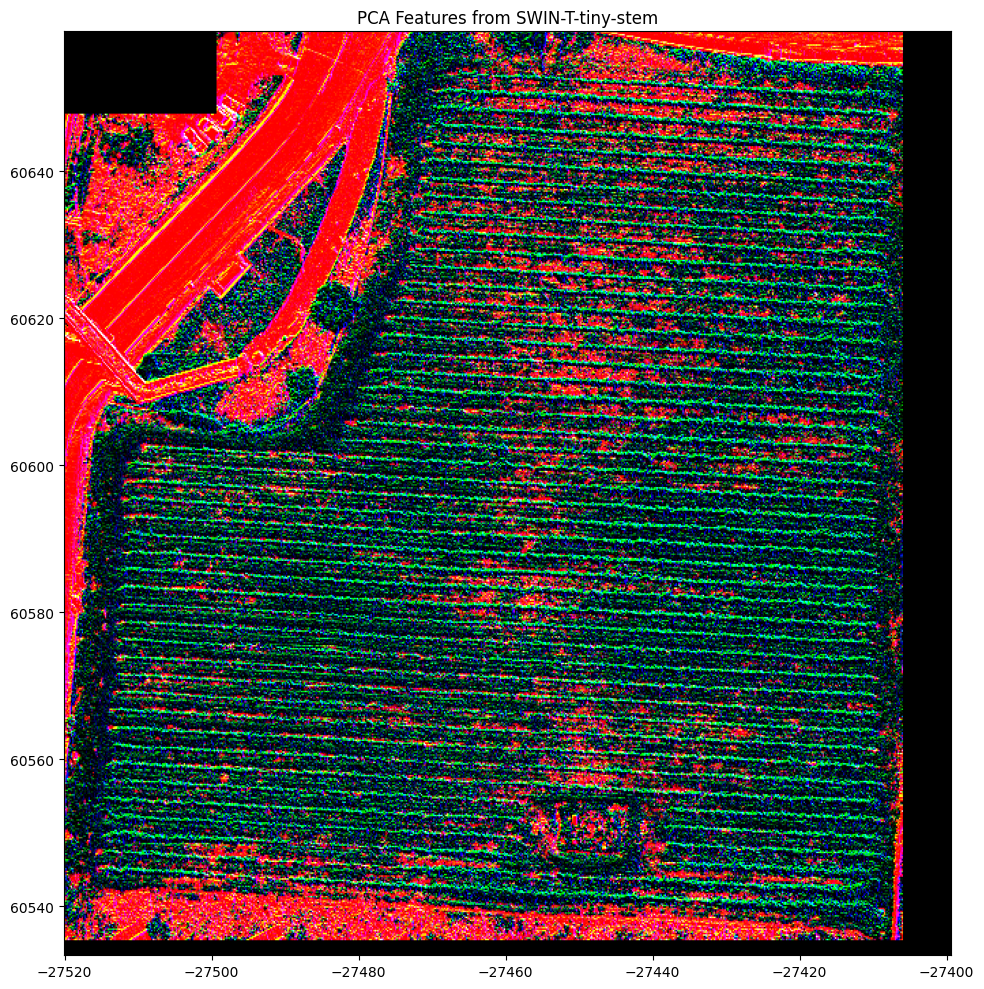

In [23]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = e1_pca_swin.values.transpose(2,1,0)
e = [esac1_ortho.x.min(), esac1_ortho.x.max(), 
                       esac1_ortho.y.min(), esac1_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem')
save_path = "figs/swin_l4_e1.png"
plt.savefig(save_path, dpi=1000, bbox_inches='tight')

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.3543963..7.765608].


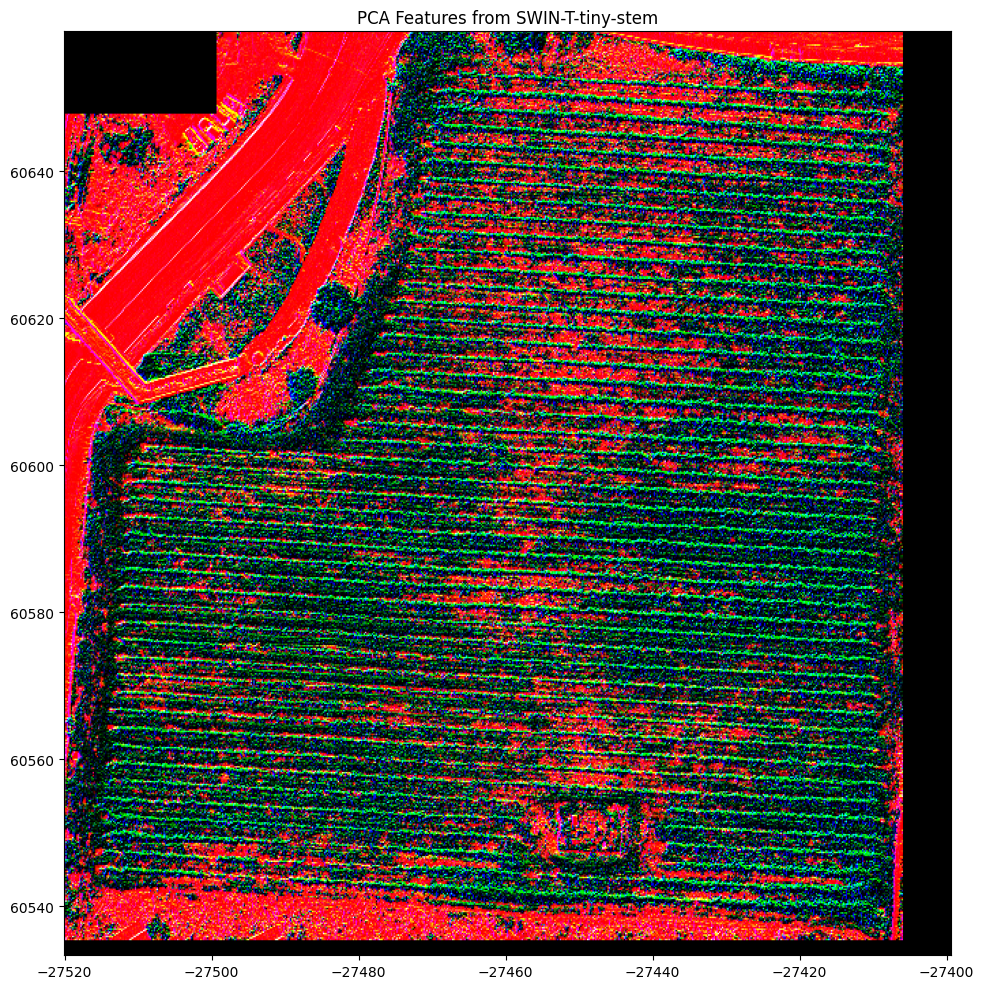

In [25]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = e1_pca_swin_ee.values.transpose(2,1,0)
e = [esac1_ortho.x.min(), esac1_ortho.x.max(), 
                       esac1_ortho.y.min(), esac1_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem')
save_path = "figs/swin_l4_e1ee.png"
plt.savefig(save_path, dpi=1000, bbox_inches='tight')

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..10.566573].


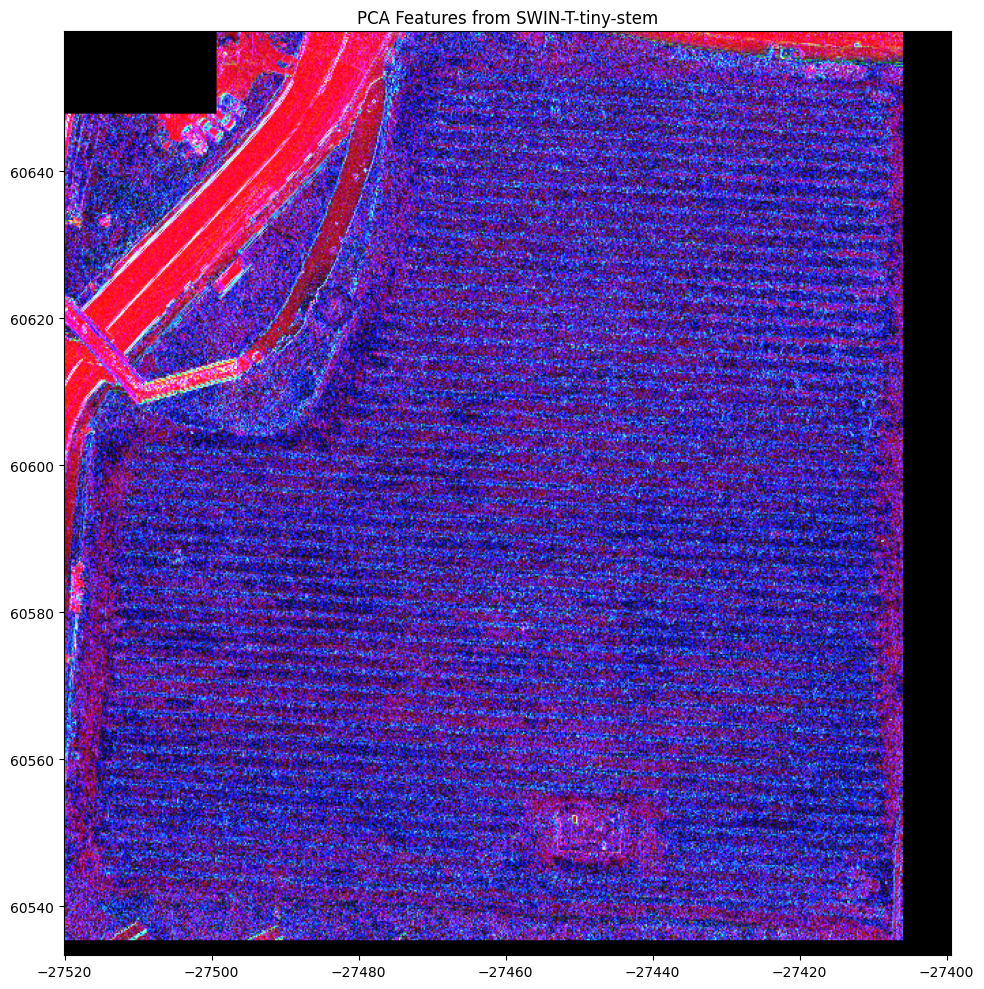

In [26]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = abs(e1_pca_swin.values.transpose(2,1,0) - e1_pca_swin_ee.values.transpose(2,1,0))
e = [esac1_ortho.x.min(), esac1_ortho.x.max(), 
                       esac1_ortho.y.min(), esac1_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem')

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.3422737..7.714517].


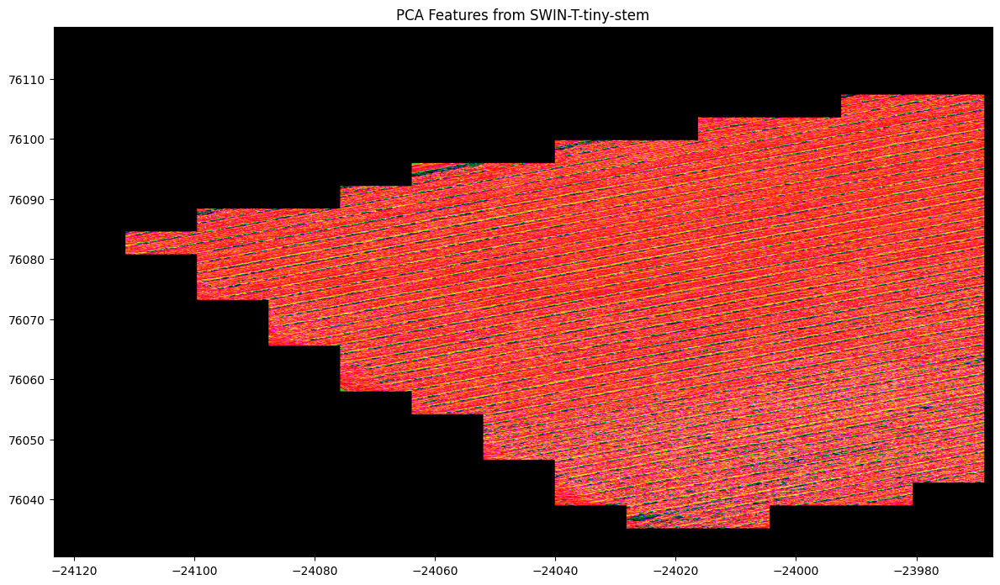

In [27]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = v_pca_swin.values.transpose(2,1,0)
e = [valdoeiro_ortho.x.min(), valdoeiro_ortho.x.max(), 
                       valdoeiro_ortho.y.min(), valdoeiro_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem')

save_path = "figs/swin_l4_val.png"
plt.savefig(save_path, dpi=1000, bbox_inches='tight')
plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.575428..6.207383].


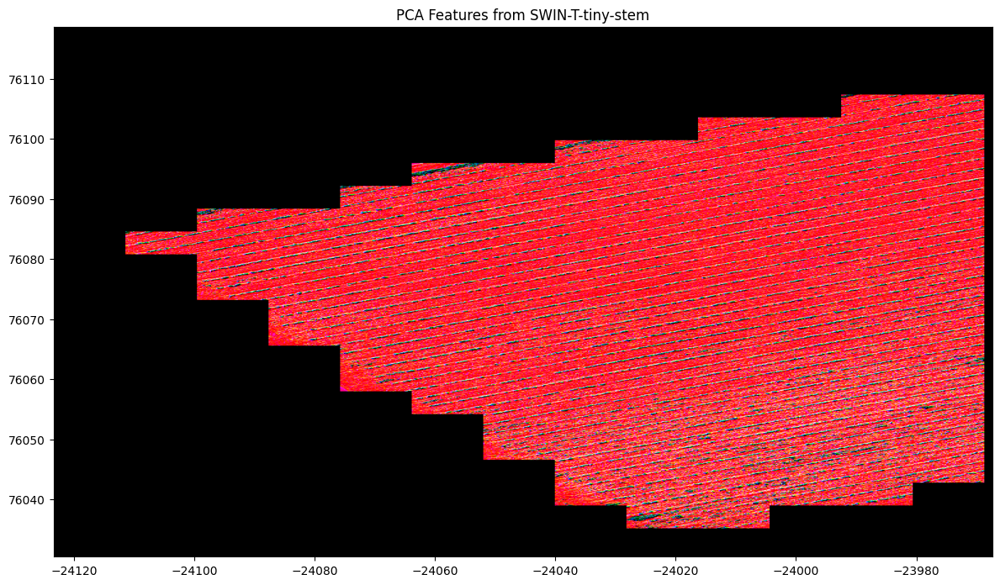

In [28]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = v_pca_swin_ee.values.transpose(2,1,0)
e = [valdoeiro_ortho.x.min(), valdoeiro_ortho.x.max(), 
                       valdoeiro_ortho.y.min(), valdoeiro_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem')

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.132312..8.4357605].


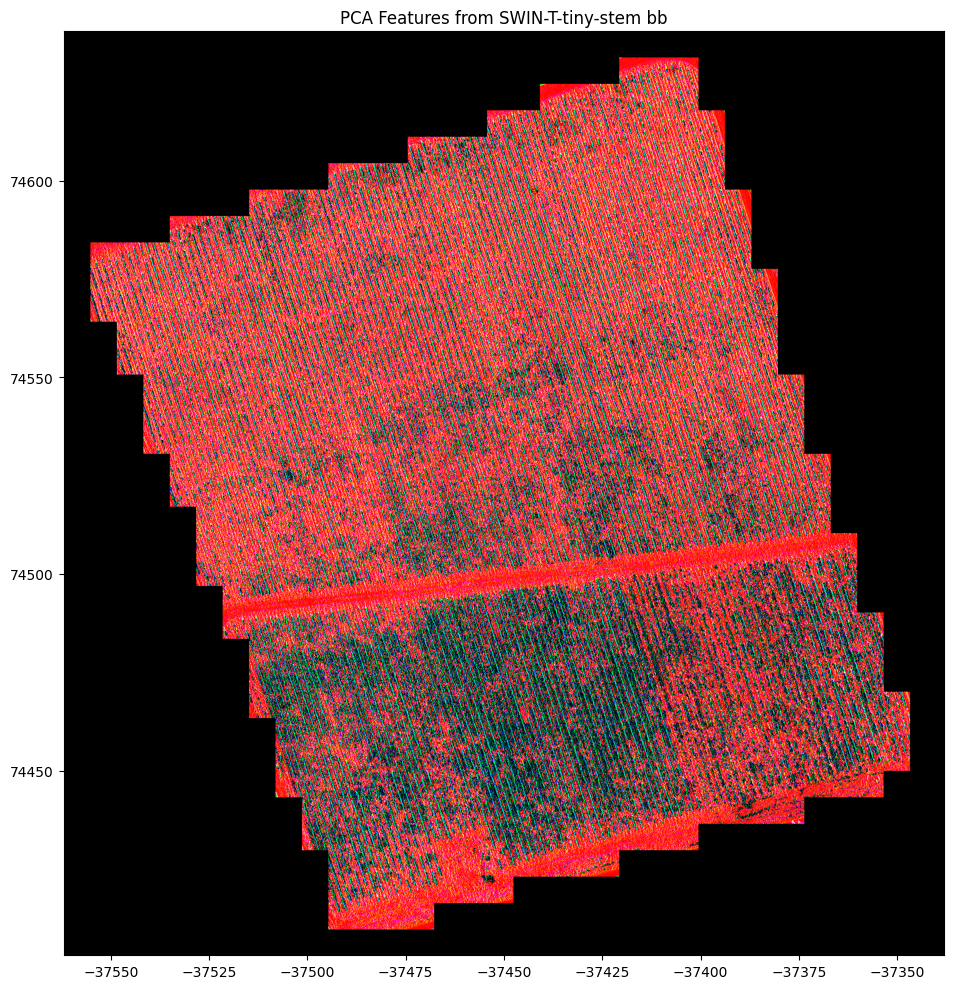

In [34]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = q_pca_swin.values.transpose(1,2,0)
e = [qbaixo_ortho.x.min(), qbaixo_ortho.x.max(), 
                       qbaixo_ortho.y.min(), qbaixo_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem bb')

save_path = "figs/swin_stem_q.png"
plt.savefig(save_path, dpi=1000, bbox_inches='tight')

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.889285..7.287473].


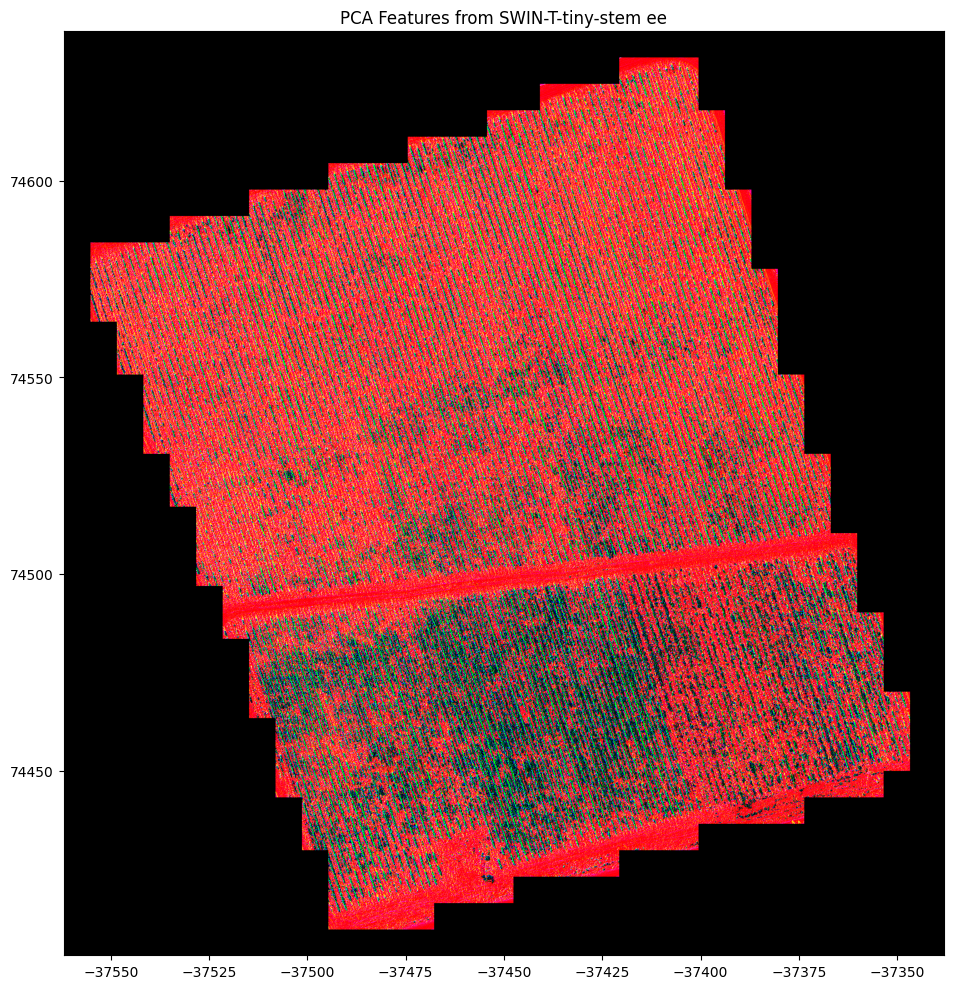

In [35]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = q_pca_swin_ee.values.transpose(1,2,0)
e = [qbaixo_ortho.x.min(), qbaixo_ortho.x.max(), 
                       qbaixo_ortho.y.min(), qbaixo_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

plt.title('PCA Features from SWIN-T-tiny-stem ee')

save_path = "figs/swin_ee_q.png"
plt.savefig(save_path, dpi=1000, bbox_inches='tight')

plt.tight_layout()
plt.show()

In [29]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
from typing import List, Tuple, Optional

def plot_rgb_like_prediction_histograms(
    prediction_arrays: List[Tuple[xr.DataArray, xr.DataArray]],
    location_names: List[str],
    layer_names: List[str] = ["Layer 1", "Layer 2", "Layer 3"],
    bins: int = 50,
    figsize: Tuple[int, int] = (16, 12),
    save_path: Optional[str] = None,
    drop_zeros: bool = True
):
    """
    Plot histograms of prediction values for RGB-like arrays (3 layers on 0-1 scale)
    comparing multiple locations side by side.
    
    Args:
        prediction_arrays: List of tuples, each containing two prediction arrays for a location
        location_names: Names of the locations for plot titles
        layer_names: Names of the three layers (defaults to "Layer 1", "Layer 2", "Layer 3")
        bins: Number of bins for the histogram
        figsize: Figure size
        save_path: Optional path to save the figure
        drop_zeros: Whether to exclude zero values from the histogram
    """
    # Determine number of locations
    n_locations = len(prediction_arrays)
    n_layers = 3  # Assuming RGB-like structure with 3 layers
    
    # Set up the figure
    fig, axes = plt.subplots(n_layers, n_locations * 2, figsize=figsize)
    
    # Plot histograms for each location and prediction array
    for loc_idx, (loc_preds, loc_name) in enumerate(zip(prediction_arrays, location_names)):
        for pred_idx, pred_array in enumerate(loc_preds):
            # Convert to numpy if it's an xarray
            if isinstance(pred_array, xr.DataArray):
                # Check if the array has a 'band' or similar dimension
                if 'band' in pred_array.dims:
                    pred_data = pred_array.values
                elif 'class' in pred_array.dims:
                    pred_data = pred_array.values
                else:
                    # If it's a 3D array without named dimensions
                    pred_data = pred_array.values
            else:
                # Already a numpy array
                pred_data = pred_array
                
            # Make sure pred_data has the right shape [layers, height, width]
            if pred_data.ndim == 3:
                if pred_data.shape[0] == 3:  # [3, H, W]
                    pass  # Already in the right format
                elif pred_data.shape[2] == 3:  # [H, W, 3]
                    pred_data = np.transpose(pred_data, (2, 0, 1))
            else:
                raise ValueError(f"Unexpected array shape: {pred_data.shape}")
                
            # Process each layer
            for layer_idx in range(n_layers):
                # Get data for this layer
                layer_data = pred_data[layer_idx].flatten()
                
                # Remove zeros if requested
                if drop_zeros:
                    layer_data = layer_data[layer_data > 0]
                    layer_data = layer_data[layer_data < 1]
                
                # Skip if no data
                if len(layer_data) == 0:
                    continue
                
                # Get the appropriate axis
                ax = axes[layer_idx, loc_idx * 2 + pred_idx]
                
                # Plot histogram
                ax.hist(layer_data, bins=bins, alpha=0.7)
                ax.set_title(f"{loc_name} - Pred {pred_idx+1} - {layer_names[layer_idx]}")
                ax.set_ylabel("Frequency")
                ax.set_xlabel("Value")
                
                # Add statistics
                ax.text(0.02, 0.95, 
                       f"Mean: {layer_data.mean():.3f}\nStd: {layer_data.std():.3f}", 
                       transform=ax.transAxes, 
                       bbox=dict(facecolor='white', alpha=0.7))
    
    # Adjust layout
    plt.tight_layout()
    
    # Save if requested
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
    
    return fig, axes

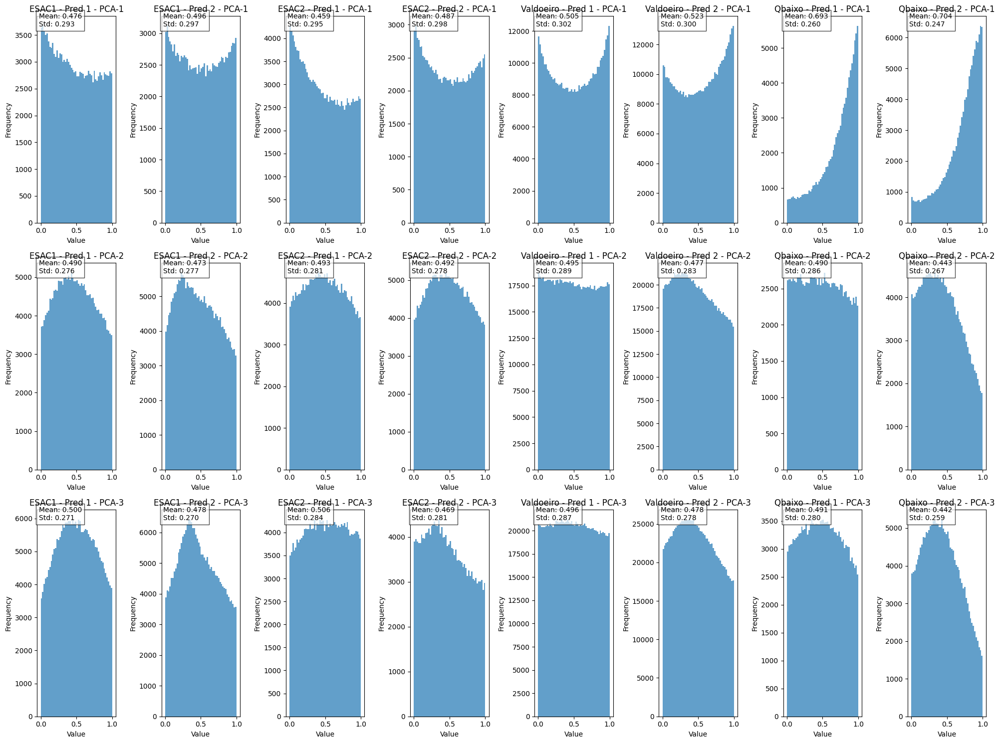

In [30]:
location_names = ["ESAC1", "ESAC2", "Valdoeiro", "Qbaixo"]
layer_names = ["PCA-1", "PCA-2", "PCA-3"]  # Or any appropriate names for your 3 layers
prediction_arrays = [(e1_pca_swin,e1_pca_swin_ee),
                     (e2_pca_swin,e2_pca_swin_ee),
                     (q_pca_swin,q_pca_swin_ee),
                     (v_pca_swin,v_pca_swin_ee)]
fig, axes = plot_rgb_like_prediction_histograms(
    prediction_arrays=prediction_arrays,
    location_names=location_names,
    layer_names=layer_names,
    bins=50,
    figsize=(20, 15),
    save_path="histograms.png",
    drop_zeros=True  # Set to False if you want to include zeros
)

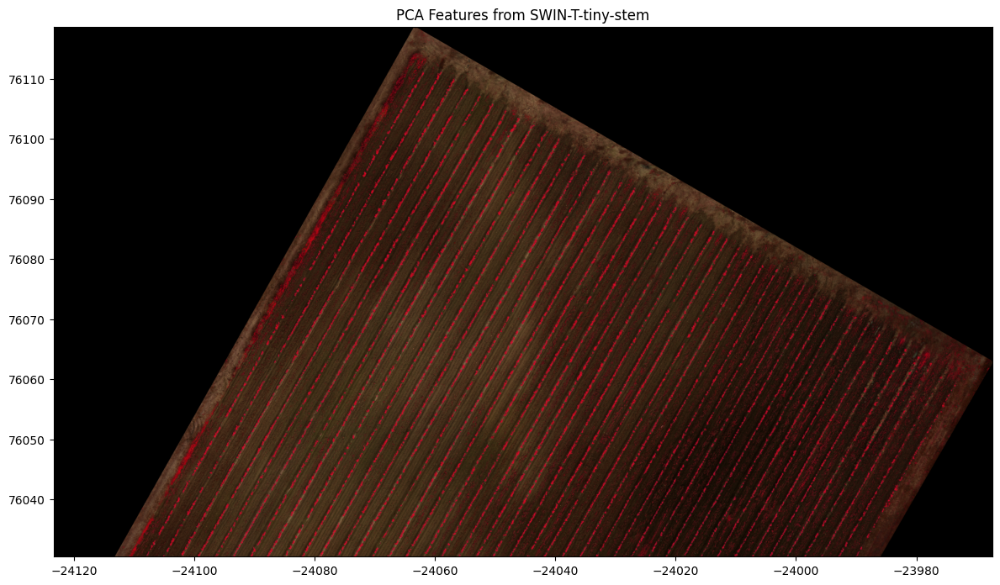

In [36]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb =valdoeiro_ortho.values.transpose(1,2,0)
rgb = np.stack([rgb[:, :, 3], rgb[:, :, 1], rgb[:, :, 0]], axis=-1)  # (H, W, 3)
e = [valdoeiro_ortho.x.min(), valdoeiro_ortho.x.max(), 
                       valdoeiro_ortho.y.min(), valdoeiro_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem')

save_path = "figs/false_v.png"
plt.savefig(save_path, dpi=1000, bbox_inches='tight')

plt.tight_layout()
plt.show()

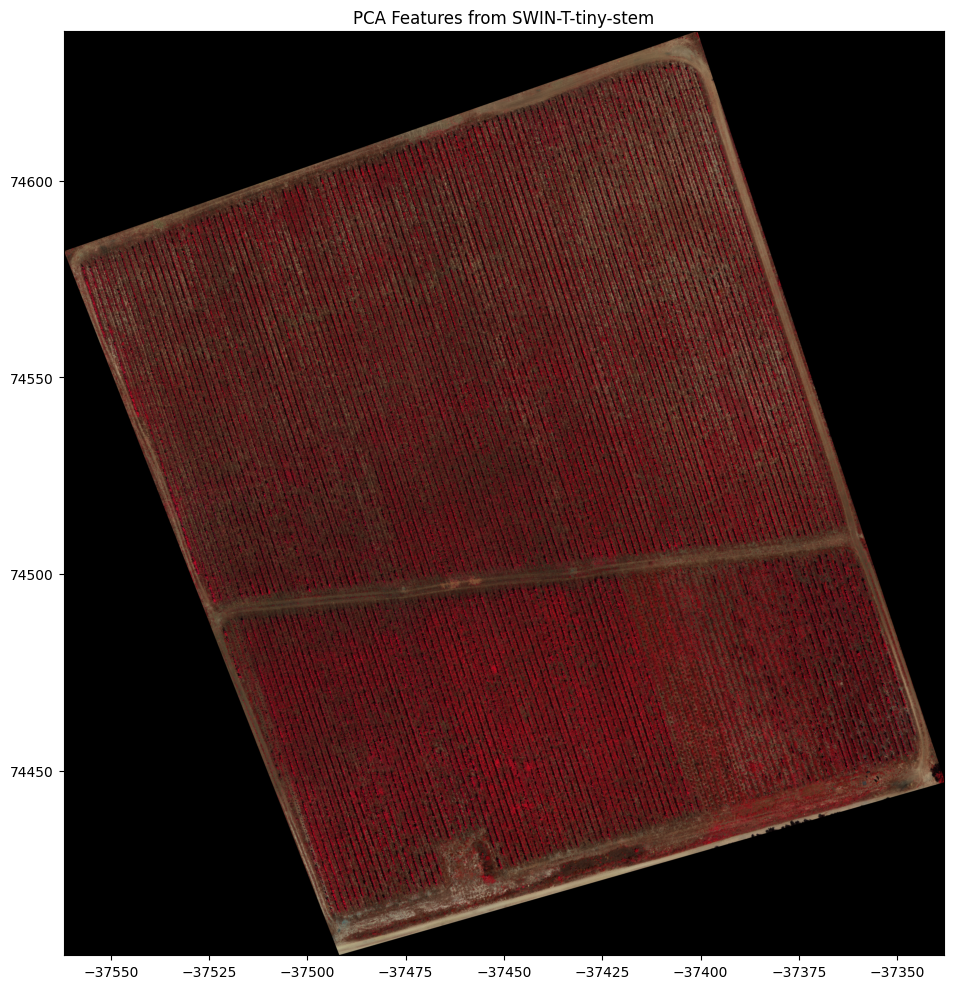

In [37]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = qbaixo_ortho.values.transpose(1,2,0)
rgb = np.stack([rgb[:, :, 3], rgb[:, :, 1], rgb[:, :, 0]], axis=-1)  # (H, W, 3)
e = [qbaixo_ortho.x.min(), qbaixo_ortho.x.max(), 
                       qbaixo_ortho.y.min(), qbaixo_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem')

save_path = "figs/false_q.png"
plt.savefig(save_path, dpi=1000, bbox_inches='tight')

plt.tight_layout()
plt.show()

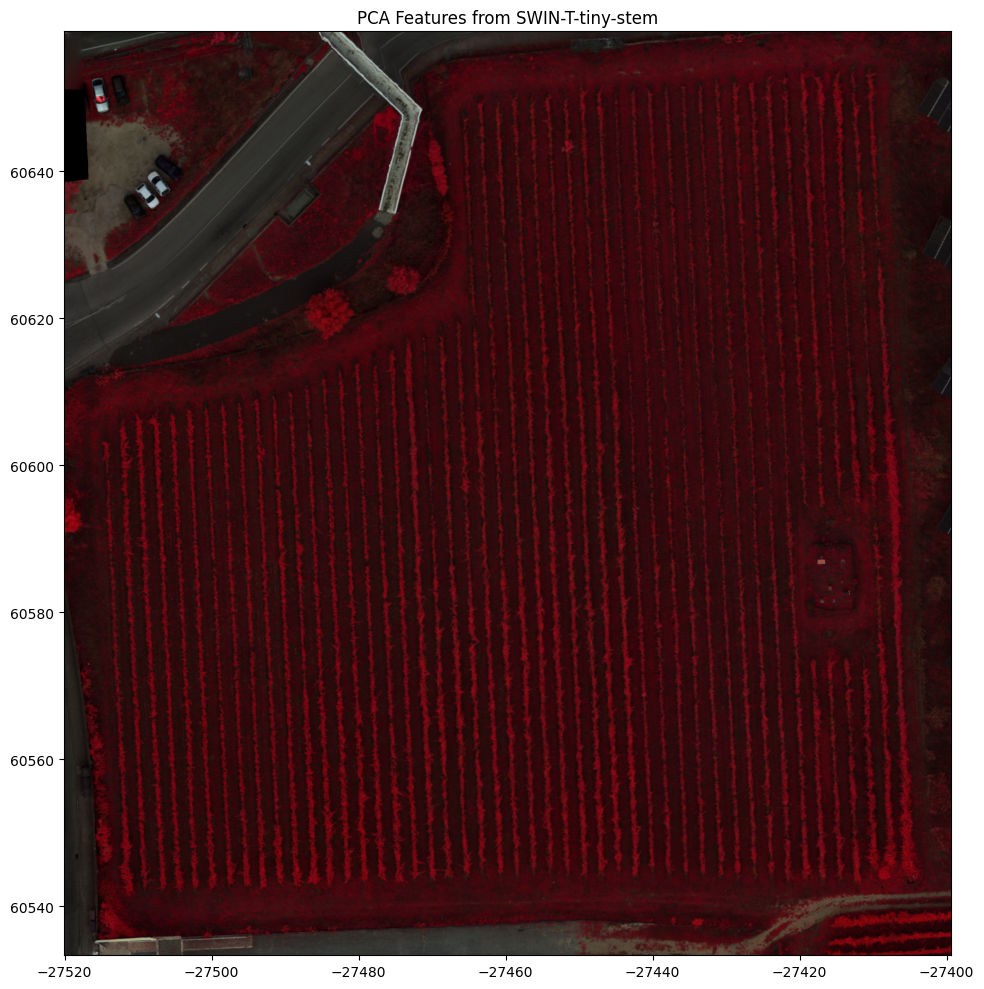

In [38]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(12, 10))

rgb = esac1_ortho.values.transpose(1,2,0)
rgb = np.stack([rgb[:, :, 3], rgb[:, :, 1], rgb[:, :, 0]], axis=-1)  # (H, W, 3)
e = [esac1_ortho.x.min(), esac1_ortho.x.max(), 
                       esac1_ortho.y.min(), esac1_ortho.y.max()]
# Display the RGB image
ax.imshow(rgb, extent=e)

# Add a title
plt.title('PCA Features from SWIN-T-tiny-stem')

save_path = "figs/false_e1.png"
plt.savefig(save_path, dpi=1000, bbox_inches='tight')

plt.tight_layout()
plt.show()